# Advanced Optimization: Part 2 - Nonlinear

Material is compiled by Shriya Karam from the following sources:
- Conceptual content from Convex Optimization (Boyd and Vandenberghe)
- Code from Optimization Methods Fall 2024 (Sean Lo in nonlinear optimization)

## Nonlinear background

Nonlinear optimization (or nonlinear programming) is the term used to describe an optimization problem when the objective or constraint functions are not linear. In this session, we will cover the basics behind nonlinear optimization and a few methods for the general nonlinear programming problem. 

### Basics of convex optimization (more on this in Session 7)

Convex optimization problems are defined through the notion of convex sets.

**Convex set**

<img src="figures/convex_set.png" alt="Drawing1" style="width: 700px;"/>

**Convex function**

<img src="figures/convex_function.png" alt="Drawing1" style="width: 500px;"/>

**Convex optimization problems**

A general convex optimization problem has
the following form:
$$
\begin{array}{ll}
\underset{x\in\mathbf{R}^{d}}{\text{minimize}} & f_{0}(x)\\
\text{subject to} & a_{i}^{\top}x=b_{i},\quad i=1,\ldots,p,\\
 & f_{i}(x)\leq0,\quad i=1,\ldots,m.
\end{array}
$$
 where the equality constraints are linear and the functions $f_{0},f_{1},\ldots,f_{m}$
are convex. 

**How do you tell if a problem is convex?**

We need to check the convexity of a function via a few possible approaches:

1. First-order condition: a function $f$ (assume differentiable) is convex if and only if $ f(y) \geq f (x) + \nabla f (x)^T(y − x), \forall x$. This means that the first-order Taylor approximation underestimates the function $f$.  

2. Second-order condition: a function $f$ (assume twice continuously differentiable) is a convex function if and only if the Hessian is positive semidefinite for all $x$. Recall that the Hessian is the matrix of second partial derivatives. The Hessian is positive semi-definite if $u ^T A u \geq 0$ for all $u$. Alternatively, the Hessian is positive semi-definite if and only if all its eigenvalues are nonnegative. 
 
3. Convex calculus (more on this in Session 7)

### Unconstrained optimization

The unconstrained optimization problem is:
$$
\begin{array}{ll}
\underset{x}{\text{minimize}} & f(x)
\end{array}
$$

where $f : \mathbb{R}^n \rightarrow \mathbb{R}$ is twice continuous differentiable function. 

**Local optimization**

A local minimum is a point that minimizes the objective function among feasible points that are near it. Local minima can only occur at stationary points where $\nabla f (x ^ *) = 0$ (setting the gradient to 0). A point that is a local minimum is not necessarily guaranteed to be a global minimum.

**Global optimization**

If $f$ is convex, then $x^*$ is a global minimum of $f$ if and only if $\nabla f (x ^ *) = 0$. That is, if the function is convex, then a local minimum is a global minimum. 

**Descent methods**

This notebook focuses on descent methods, an optimization algorithm to solve nonlinear problems, which produces sequences or iterates $x^k$ , where $x^{k+1} = x^{k} + \alpha^{k} d^k$. Let's break this down further: 
- $d^k$: the search direction at each iteration $k$
- $\alpha^{k}$: step size at iteration $k$

Descent methods mean that $f(x^{k+1}) < f(x^{k})$, except when $x^k$ is optimal. The outline of a general descent method is as follows, which consists of two major steps: determining a descent direction $d$ and the selection of a step size $t$:

1. Given a starting point $x \in \textbf{dom} f$. 
2. Repeat: 

    a. Determine a descent direction $d$. 

    b. Choose a step size $\alpha > 0$ via line search.

    c. Update $x := x + \alpha d$

3. Stop when the stopping criterion is satisfied.


## Gradient descent

The gradient descent method uses the negative gradient $d = - \nabla f(x)$ for the search direction. Gradient descent works to move the function value in the direction of steepest descent, by taking a step in the direction of the negative gradient. The algorithm is as follows:

1. Given a starting point $x \in \textbf{dom} f$. 
2. Repeat: 

    a. Set $d = - \nabla f(x)$. 

    b. Line search: Choose a step size $\alpha > 0$ - either constant, exact line search, or backtracking line search. 

    c. Update. $x := x + \alpha d$

3. Stop when the stopping criterion is satisfied.

The stopping criterion is usually of the form $ \nabla || f(x) ||_2 \leq \epsilon$, where $\epsilon$ is small and positive. Let's see how it's implemented through the following two examples with a constant step size. 

### Example 1: quadratic function

Consider the problem 
$$\min_{x_1, x_2} f(x_1, x_2) := 5x_1^2 + x_2^2 + 4 x_1 x_2 - 14 x_1 - 6 x_2 + 20$$
This is a quadratic in $\bm{x} = (x_1, x_2)$, since we can write $f$ as:
$$f(\bm{x}) = \frac{1}{2} \bm{x}^\top  \bm{Q} \bm{x} - \bm{c}^\top \bm{x} + b$$
with $\bm{Q} = \begin{pmatrix} 10 & 4 \\ 4 & 2 \end{pmatrix}$, $\bm{c} = \begin{pmatrix} 14 \\ 6 \end{pmatrix}$, and $b = 20$.

This function is convex. Because it is in the quadratic form, we can check whether the matrix $Q$ is positive semi-definite. We can verify that $Q$ has all nonnegative eigenvalues, so is positive semi-definite, and the function is convex. Trust me on this or take the eigenvalues yourself :) 

Remember on convex functions, a local minimum is a global minimum, so gradient descent will give us the global minimum!

In [2]:
using Plots, LinearAlgebra, CSV, DataFrames, Random, NLsolve

In [3]:
function cost_function_quadratic(x::Vector)
    return 5 * x[1]^2 + x[2]^2 + 4 * x[1] * x[2] - 14 * x[1] - 6 * x[2] + 20
end

function gradient_quadratic(x::Vector)
    return [
        10 * x[1] + 4 * x[2] - 14,
         2 * x[2] + 4 * x[1] - 6,
    ]
end

gradient_quadratic (generic function with 1 method)

We now implement gradient descent with constant step size:

In [4]:
function gradient_descent_constant(
    cost_function::Function,
    gradient::Function,
    initial_x::Vector,  # Initial point
    alpha,              # Step size
    epsilon,            # Termination parameter
)
    # Initialization
    x = initial_x
    k = 0
    x_history = zeros(Float64, (0, 2))
    cost_history = Float64[]
    gradient_norm_history = Float64[]

    while true
        # Find descent direction d
        gradient_val = gradient(x)
        d = - gradient_val
        cost_function_val = cost_function(x)
        gradient_norm = norm(gradient_val)
        # Update history
        x_history = vcat(x_history, x')
        push!(cost_history, cost_function_val)
        push!(gradient_norm_history, gradient_norm)
        if gradient_norm < epsilon
            break
        end
        # Update x
        x = x + alpha * d
        # Increment iteration count
        k += 1
    end
    return Dict(
        "x" => x_history,
        "cost" => cost_history,
        "gradient_norm" => gradient_norm_history,
    )
end

gradient_descent_constant (generic function with 1 method)

Let's see the result:

In [5]:
initial_x = [0, 10];
epsilon = 1e-5;

results_quadratic_constant = @time gradient_descent_constant(
    cost_function_quadratic,
    gradient_quadratic,
    initial_x, 
    0.1, 
    epsilon,
)

  0.487345 seconds (1.20 M allocations: 61.778 MiB, 3.68% gc time, 99.92% compilation time)


Dict{String, Array{Float64}} with 3 entries:
  "cost"          => [60.0, 23.12, 21.3152, 20.5267, 19.816, 19.1539, 18.5364, …
  "gradient_norm" => [29.5296, 5.65685, 2.89772, 2.69105, 2.59559, 2.50644, 2.4…
  "x"             => [0.0 10.0; -2.6 8.6; … ; 0.999989 1.00003; 0.999989 1.0000…

In [6]:
# Define the range of x and y values
x_range = -10:0.1:10
y_range = -10:0.1:10
grid = [(x, y) for x in x_range, y in y_range]

z = [cost_function_quadratic([x, y]) for (x, y) in grid]
z = reshape(z, length(x_range), length(y_range));

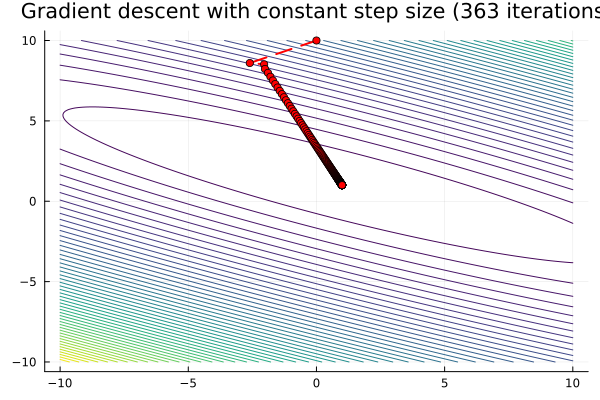

In [7]:
contour_quadratic_constant = contour(
    x_range, y_range, z, 
    levels = 50, 
    c = :viridis, color = :auto, 
    legend = false,
)
Plots.plot!(
    results_quadratic_constant["x"][:,1],
    results_quadratic_constant["x"][:,2],
    linestyle = :dash,
    linewidth = 2,
    markershape = :circle, 
    color = :red,
    title = "Gradient descent with constant step size ($(length(results_quadratic_constant["cost"])) iterations)"
)
contour_quadratic_constant

### Example 2: Rosenbrock function

What happens when we move beyond convex optimization? We minimize the [Rosenbrock function](https://en.wikipedia.org/wiki/Rosenbrock_function), a nonconvex function, which is often used as a test problem for optimization algorithms:
\begin{align*}   
    \min_{x_1, x_2} f(x_1, x_2) := 100(x_2 - x_1^2)^2 + (1 - x_1)^2
\end{align*}

\begin{align*}
    \nabla f(\bm{x}) = \begin{pmatrix}
        - 400 x_1 (x_2 - x_1^2) - 2 (1 - x_1)
        \\
        200 (x_2 - x_1^2)
    \end{pmatrix}
\end{align*}

In [8]:
function cost_function_rosenbrock(x)
    return 100 * (x[2] - x[1]^2)^2 + (1 - x[1])^2
end

function gradient_rosenbrock(x)
    return [
        - 400 * x[1] * (x[2] - x[1]^2) - 2*(1 - x[1]),
          200 * (x[2] - x[1]^2),
    ]
end

gradient_rosenbrock (generic function with 1 method)

In [9]:
initial_x_rosenbrock = [0.25, 4.5]

results_rosenbrock_constant = @time gradient_descent_constant(
    cost_function_rosenbrock,
    gradient_rosenbrock,
    initial_x_rosenbrock,
    0.001,
    epsilon,
);

# Define the range of x and y values
# Define the range of x and y values
x_range = 0:0.01:3
y_range = 0:0.01:5
grid = [(x, y) for x in x_range, y in y_range]

z = [cost_function_rosenbrock([x y]) for (x, y) in grid]
z = reshape(z, length(x_range), length(y_range))'
;

  1.502902 seconds (449.30 k allocations: 6.222 GiB, 44.84% gc time, 1.68% compilation time)


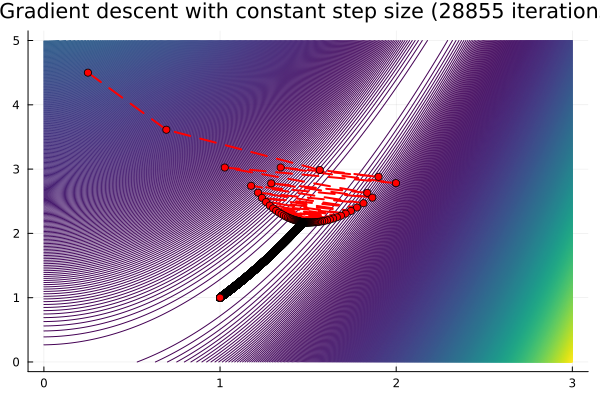

In [10]:
contour_rosenbrock_constant = contour(
    x_range, y_range, z, 
    levels = 1000, 
    c = :viridis, color = :auto, 
    legend = false,
)
Plots.plot!(
    results_rosenbrock_constant["x"][:,1],
    results_rosenbrock_constant["x"][:,2],
    linestyle = :dash,
    linewidth = 2,
    markershape = :circle, 
    color = :red,
    title = "Gradient descent with constant step size ($(length(results_rosenbrock_constant["cost"])) iterations)"
)
contour_rosenbrock_constant

Comparing gradient descent on the quadratic (convex) and Rosenbrock (nonconvex) functions, we notice some differences. Namely, it takes a lot more iterations to converge to the local minimum for the Rosenbrock function (28855 iterations) versus the quadratic function (363 iterations). With nonconvex optimization, we can have slow convergence to local minima. Also, we ended up a local minimum for the Rosenbrock function which may not be a global minimum!

This motivates the question: how do we improve classic gradient descent for non-convex functions? 

### Choosing the step size

An important design consideration in descent methods is the selection of the step size. Small step sizes lead to slower convergence and little progress of the algorithm at each iteration. Larger step sizes may lead to faster convergence but also instability as the algorithm may miss local optima altogether. The previous examples used a constant step size and we now see how "smarter'' step sizes improve the algorithm's convergence.  

**Exact line search**

We first look at exact line search as a line search method, where the step size $\alpha$ is chosen to minimize $f$ along the ray $ \{ x + \alpha d | \alpha \geq 0 \}$, i.e.:

$$\alpha_k = \argmin_{\alpha \geq 0} f(x^{k} + \alpha d ^ {k})$$ 

In other words, we choose the step size $\alpha$ such that we maximize the algorithm's improvement at each iteration. While exact line search may result in fewer iterations and faster convergence, it's useful when the computational cost of the above minimization problem is low relative to the cost of computing the search direction. For example, let's implement gradient descent with exact line search using the quadratic function example. To do so, we should find $\alpha_k$ at each iteration depending on $x^k$. Since we have a quadratic optimization problem, the problem $\min_{\alpha} f(x^k + \alpha d^k)$ has the closed-form solution:

\begin{align}
    \alpha_k = \frac{
        (d^k_1)^2 + (d^k_2)^2
    }{
        2 \Big( 5 (d^k_1)^2 + (d^k_2)^2 + 4 d^k_1 d^k_2\Big)
    }
\end{align}

In [11]:
function gradient_descent_exact_linesearch(
    cost_function::Function, 
    gradient::Function,
    initial_x::Vector,  # Initial point
    epsilon,            # Termination parameter
)
    # Initialization
    x = initial_x
    k = 0
    x_history = zeros(Float64, (0, 2))
    cost_history = Float64[]
    gradient_norm_history = Float64[]
    alpha_history = Float64[]

    while true
        # Find descent direction d
        gradient_val = gradient(x)
        d = - gradient_val
        cost_function_val = cost_function(x)
        gradient_norm = norm(gradient_val)
        # Compute step size alpha
        alpha = (d[1]^2 + d[2]^2) / (2 * (5 * d[1]^2 + d[2]^2 + 4 * d[1] * d[2]))
        # Update history
        x_history = vcat(x_history, x')
        push!(cost_history, cost_function_val)
        push!(gradient_norm_history, gradient_norm)
        push!(alpha_history, alpha)
        if gradient_norm < epsilon
            break
        end
        # Update x
        x = x + alpha * d
        # Increment iteration count
        k += 1
    end
    return Dict(
        "x" => x_history,
        "cost" => cost_history,
        "gradient_norm" => gradient_norm_history,
        "alpha" => alpha_history,
    )
end

gradient_descent_exact_linesearch (generic function with 1 method)

In [12]:
initial_x = [0, 10]
epsilon = 1e-5
;

results_quadratic_exact_linesearch = @time gradient_descent_exact_linesearch(
    cost_function_quadratic,
    gradient_quadratic,
    initial_x, 
    epsilon,
)

  0.070093 seconds (142.62 k allocations: 7.447 MiB, 99.84% compilation time)


Dict{String, Array{Float64}} with 4 entries:
  "cost"          => [60.0, 22.2226, 12.9878, 10.7304, 10.1785, 10.0436, 10.010…
  "gradient_norm" => [29.5296, 2.91071, 7.21857, 0.711528, 1.76459, 0.173934, 0…
  "alpha"         => [0.0866455, 2.18, 0.0866455, 2.18, 0.0866455, 2.18, 0.0866…
  "x"             => [0.0 10.0; -2.25278 8.78696; … ; 0.999997 1.00003; 0.99999…

In [13]:
# Define the range of x and y values
x_range = -10:0.1:10
y_range = -10:0.1:10
grid = [(x, y) for x in x_range, y in y_range]

z = [cost_function_quadratic([x, y]) for (x, y) in grid]
z = reshape(z, length(x_range), length(y_range))'
;

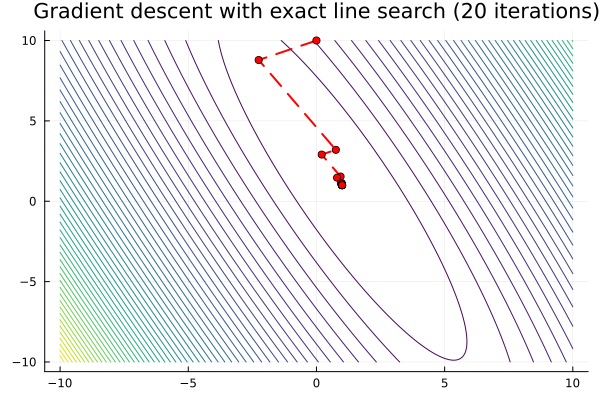

In [14]:
contour_quadratic_exact_linesearch = contour(
    x_range, y_range, z, 
    levels = 50, 
    c = :viridis, color = :auto, 
    legend = false,
)
Plots.plot!(
    results_quadratic_exact_linesearch["x"][:,1],
    results_quadratic_exact_linesearch["x"][:,2],
    linestyle = :dash,
    linewidth = 2,
    markershape = :circle, 
    color = :red,
    title = "Gradient descent with exact line search ($(length(results_quadratic_exact_linesearch["cost"])) iterations)"
)
contour_quadratic_exact_linesearch

With exact line search, we see that we get to the optimum at fewer iterations, compared to gradient descent with a constant step size (363 vs 20 iterations). We see that because we explicitly maximize the improvement at each iteration, we make more progress at each iteration and therefore get faster convergence. In this particular case, the optimal step size at each iteration can be computed analytically, so the computational cost per iteration is about the same as gradient descent with constant step size. 

**Backtracking line search**

Another line search is backtracking line search, which is not an exact approach, but is more of a heuristic. The general idea is that it starts with a large step size and reduces the step size until we have high benefits with respect to the first order approximation. Relative to exact line search, it requires less computational cost at each iteration, but may result in more iterations to converge. The method is as follows:

1. Given a descent direction $d$ for $f$ at $x \in \textbf{dom} f$, $\sigma \in (0, 0.5), \beta \in (0, 1)$.

2. Set $\alpha = 1$. 

3. While $f(x + \alpha d) > f(x) + \sigma \alpha \nabla f(x)^T d$, then let $\alpha = \beta \alpha$.

Backtracking line search requires two parameters: $\sigma$ and $\beta$. It starts with unit step size and then reduces it by the factor $\beta$ until the stopping condition is reached. 

**Visualization** 

The following figure shows the backtracking condition. The notation is a bit flipped here, where $t$ refers to the step size, $\alpha$ refers to the backtracking parameter $\sigma$, and $\Delta x$ refers to the direction $d$. 

<img src="figures/backtracking.png" alt="Drawing1" style="width: 500px;"/>

The figure shows the curve $f$ and the upper dotted line shows the line over which we search. The backtracking stopping condition holds for $t \geq t_0$ where we reduce the step size by a factor $\beta$. When the curve $f$ and the dotted line intersect, we stop updating the step size and update our iterate $x$.  

In your homework, you will be doing a guided implementation of backtracking line search!